<a href="https://colab.research.google.com/github/imonikheayeni/imonikheayeni/blob/main/AirBnBMain_(3).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **A Comparative Analysis of Ridge Regression and Random Forest Models for Predicting airbnb_df Prices with Exploratory Data Analysis**

by

## Imonikhe Ayeni

# **Abstract**
This project investigates the prediction of airbnb_df prices using machine learning models, with a focus on Ridge Regression and Random Forest. The study includes a detailed exploratory data analysis (EDA) to uncover patterns, relationships, and insights within the dataset. Key metrics such as Mean Absolute Error (MAE), Mean Squared Error (MSE), Root Mean Squared Error (RMSE), and R-squared (R²) were used to evaluate model performance. The Random Forest model consistently outperformed Ridge Regression, achieving a lower MAE (0.3169 vs. 0.3464) and a higher R² (0.5855 vs. 0.5254). These findings demonstrate the importance of EDA and selecting robust models, particularly in capturing the non-linear relationships inherent in pricing real estate listings.

# **Introduction**
The rise of airbnb_df as a global short-term rental platform has introduced new opportunities and challenges in price optimization. Accurate prediction of listing prices is essential for both hosts and the platform itself to maximize profitability and improve user experience. However, pricing is influenced by numerous factors, including location, room type, neighborhood group, availability, and minimum stay requirements.

This project begins with an exploratory data analysis (EDA) to gain insights into the dataset, identify patterns, and address data quality issues such as missing values and outliers. EDA also informed feature selection and provided a basis for comparing two predictive models: Ridge Regression and Random Forest. Ridge Regression is a regularized linear model, while Random Forest is an ensemble learning algorithm capable of capturing non-linear relationships.

By combining EDA and robust machine learning models, this study aims to deliver a comprehensive analysis of airbnb_df price prediction and provide actionable insights for improving prediction accuracy.



## Aim and Objectives

By combining EDA and robust machine learning models, this study aims to deliver a comprehensive analysis of airbnb_df price prediction and provide actionable insights for improving prediction accuracy. This project shall achieve this  by focusing on five key objectives:

1. Analyze the dataset to uncover patterns, trends, and relationships between features and prices while addressing data quality issues such as missing values and outliers.
2. Build and evaluate machine learning models (Ridge Regression and Random Forest) to accurately predict airbnb_df listing prices based on relevant features.
3. Evaluate and compare Ridge Regression and Random Forest using metrics such as MAE, MSE, RMSE, and R² to determine which model performs better for this task.
4. Assess which features most significantly influence airbnb_df prices, providing actionable insights into factors such as location, room type, and availability.
5. Provide data-driven recommendations to stakeholders (e.g., hosts, analysts, and platform managers) to help optimize pricing strategies.

In [ ]:
!pip install category_encoders

In [ ]:
#Import necessary libraries:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from category_encoders import OneHotEncoder
from sklearn.pipeline import make_pipeline
from sklearn.metrics import mean_absolute_error
from sklearn.impute import SimpleImputer



# **Load and Explore the Data**

In [ ]:
airbnb_df = pd.read_csv(r"C:\Users\User\Desktop\Projects\airbnb_df\AB_NYC_2019.csv") #load data

In [ ]:
airbnb_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [ ]:
# Display basic information about the dataset
print(airbnb_df.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [ ]:
airbnb_df.shape

(48895, 16)

In [ ]:
airbnb_df.describe() #Basic statistics about data

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [ ]:
# Check for missing values
airbnb_df.isnull().sum()


id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

# **Data Cleaning and Preprocessing**





**Drop Redundant Columns**

In [ ]:
airbnb_df.drop(columns=['id', 'name', 'host_id', 'host_name',  'last_review'], inplace= True) #Drop redundant columns

**Handle Missing Values**

In [ ]:
# Check for missing values
airbnb_df.isnull().sum()

neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

After dropping redundant columns,  only one column (reviews per month) has missing values, a total 10052 null values. To resolve this I am going to fill the null values with 0, as the null values implies 0 review was giving for the incidence case.

In [ ]:
airbnb_df['reviews_per_month'] = airbnb_df['reviews_per_month'].fillna(0) # This code will fill the missing values with 0

In [ ]:
airbnb_df["reviews_per_month"].isna().sum() #Check for null values in the column of interest alone

0

In [ ]:
airbnb_df.isnull().sum() # checking for null values in the entire dataset

neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
dtype: int64

## **Exploratory Data Analysis**

In [ ]:
airbnb_df.columns

Index(['neighbourhood_group', 'neighbourhood', 'latitude', 'longitude',
       'room_type', 'price', 'minimum_nights', 'number_of_reviews',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

**Spatial Count of airbnb_df Listings in New York**

The table and graph below show the five Neighborhood groups in New York city, Manhattan has the highest airbnb_df listing, with a count of 21661 and Staten Island has the least number of listing at a count of 373.



In [ ]:
airbnb_df['neighbourhood_group'].value_counts(ascending=False)

neighbourhood_group
Manhattan        21661
Brooklyn         20104
Queens            5666
Bronx             1091
Staten Island      373
Name: count, dtype: int64

### Graph Showing Spatial Count of airbnb_df Listings in New York

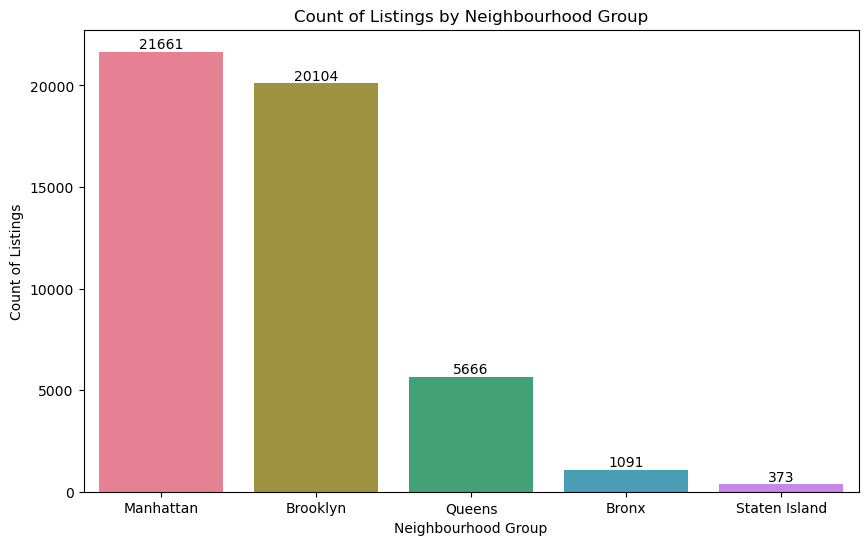

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='neighbourhood_group', data=airbnb_df, palette="husl", order=airbnb_df['neighbourhood_group'].value_counts().index)
plt.title('Count of Listings by Neighbourhood Group')
plt.xlabel('Neighbourhood Group')
plt.ylabel('Count of Listings')
# Display values on top of each bar
# Get the counts for each neighborhood group
counts = airbnb_df['neighbourhood_group'].value_counts()
for i, value in enumerate(counts.index):
    count = counts[value]  # Get the count for the current neighborhood group
    plt.text(i, count + 1, f'{count:.0f}', ha='center', va='bottom') # Display the count as an integer
plt.show()

### Spatial Distribution of airbnb_df Listings by Neighborhood Group in New York

The figure below shows the geographical spread of airbnb_df listing in New York city

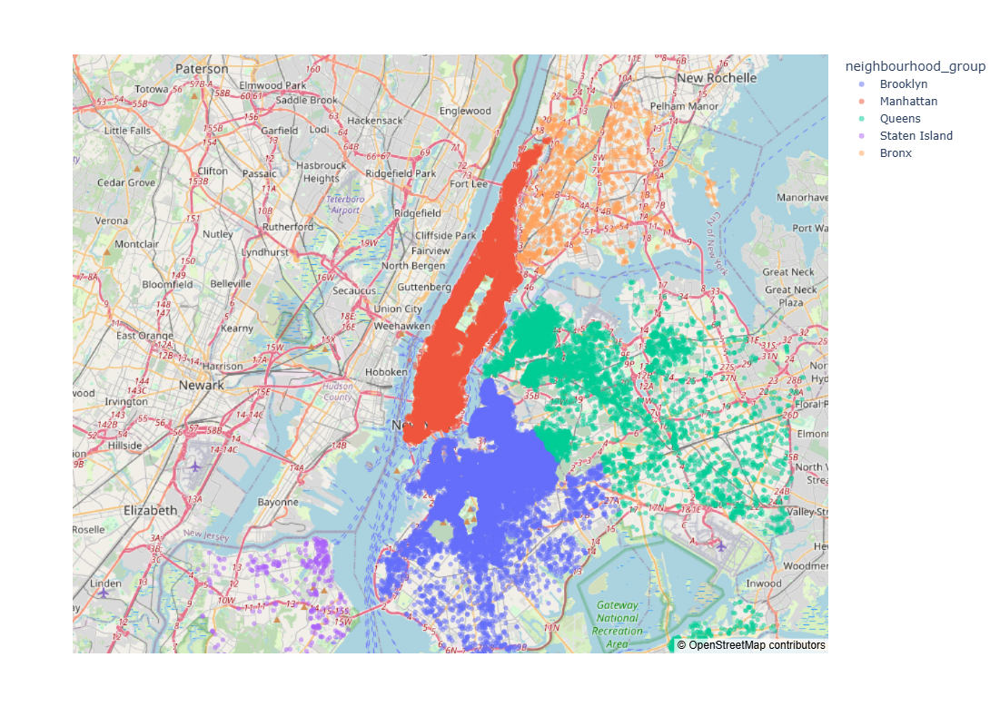

In [ ]:
# Spatial Distribution of airbnb_df Listings
map = px.scatter_mapbox(
    airbnb_df,  # Our DataFrame
    lat='latitude',  # Latitude column
    lon='longitude',  # Longitude column
    color='neighbourhood_group',  # Different colors for each neighbourhood group
    center={"lat": 40.75362, "lon": -73.98377},  # Map will be centered on Midtown, Manhattan
    width=1000,  # Width of map
    height=800,  # Height of map
    hover_data=["neighbourhood"],  # When you hover your mouse over the house, it will display the neighborhood.
    size_max=5,  # Maximum marker size
    opacity=0.5,  # Adjust opacity for better visualization
    zoom=10  # Adjust the zoom level
)
# Add mapbox_style to figure layout
map.update_layout(mapbox_style="open-street-map")

# Show figure
map.show()

### Spatial Distribution airbnb_df Listing by neighbourhood in Manhattan

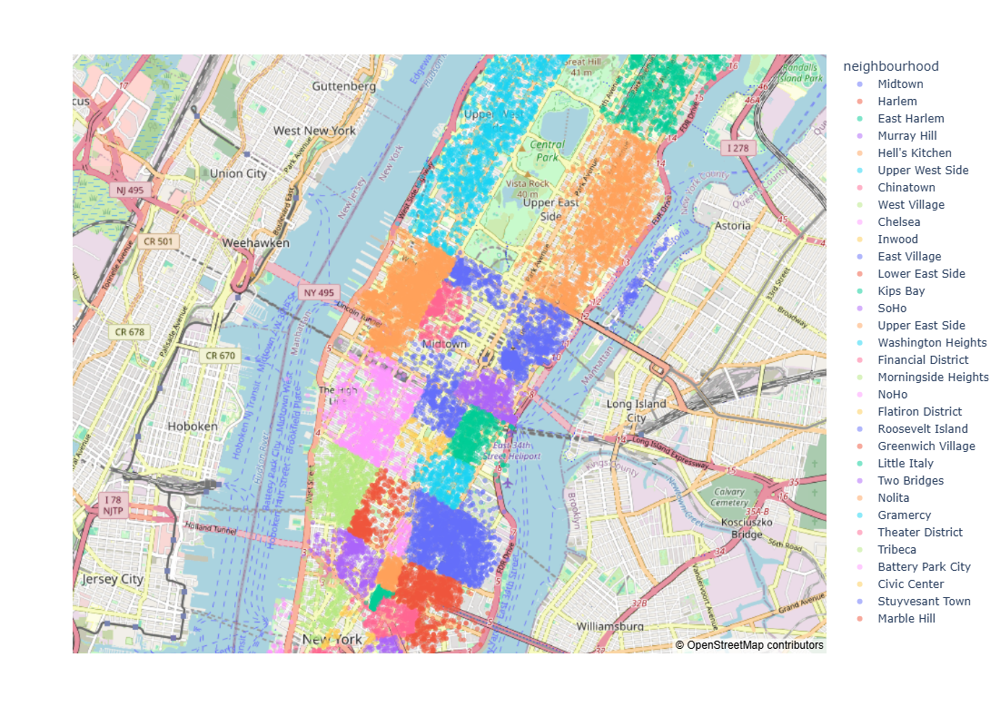

In [ ]:
# Spatial Distribution airbnb_df Listing in Manhattan
filtered_data = airbnb_df[airbnb_df['neighbourhood_group'] == 'Manhattan']

map = px.scatter_mapbox(
    filtered_data,
    lat='latitude',
    lon='longitude',
    center={"lat": 40.75362, "lon": -73.98377},
    width=800,
    height=800,
    color='neighbourhood',
    hover_data=["price"],
    size_max=5,
    opacity=0.5,
)
# Add mapbox_style to figure layout
map.update_layout(mapbox_style="open-street-map", mapbox_zoom=12)

# Show figure
map.show()

## Room Type, Minimum Nights, and Availabilty Analysis.

Lets profile our dataset set for the type of rooms listed and the availability of these listings

### Count of Listings by Room Type

In [ ]:
airbnb_df['room_type'].value_counts(ascending=False)

room_type
Entire home/apt    25409
Private room       22326
Shared room         1160
Name: count, dtype: int64

Graph Showing Count of Listings by Room Type

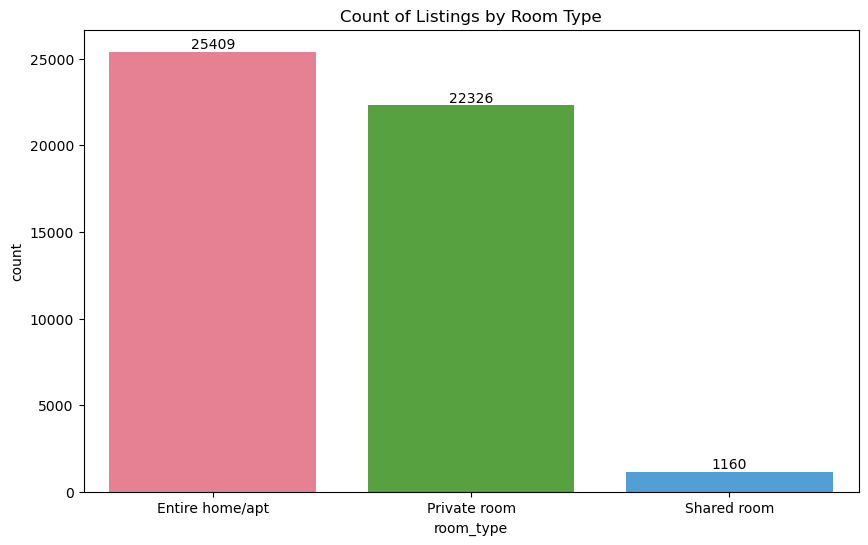

In [ ]:
# Room type analysis
plt.figure(figsize=(10, 6))
sns.countplot(x='room_type', data=airbnb_df, palette="husl", order=airbnb_df['room_type'].value_counts().index)
plt.title('Count of Listings by Room Type')
counts = airbnb_df['room_type'].value_counts()
for i, value in enumerate(counts.index):
    count = counts[value]
    plt.text(i, count + 1, f'{count:.0f}', ha='center', va='bottom')

plt.show()


### Average Availability by Neighbourhood Group

In [ ]:
average_avail=airbnb_df.groupby('neighbourhood_group')['availability_365'].mean().sort_values(ascending=False).round(2).reset_index()
average_avail

,neighbourhood_group,availability_365
0,Staten Island,199.68
1,Bronx,165.76
2,Queens,144.45
3,Manhattan,111.98
4,Brooklyn,100.23


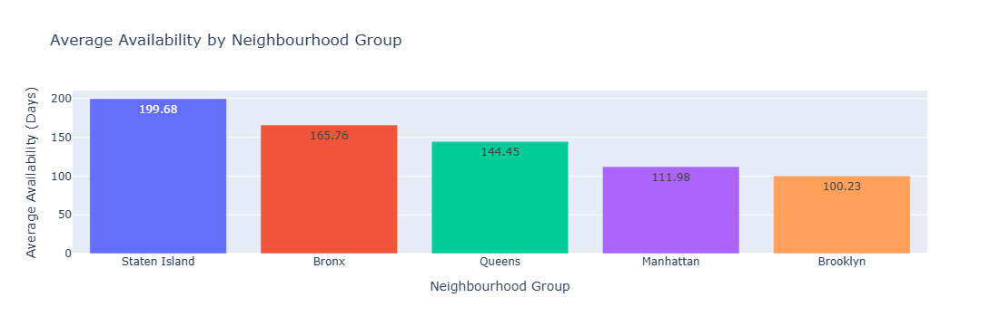

In [ ]:
# Create a bar chart with Plotly Express
fig = px.bar(
    average_avail,
    x='neighbourhood_group',  # Neighbourhood group on the x-axis
    y='availability_365',    # Average availability on the y-axis
    text ='availability_365',  # Text labels for each bar
    title='Average Availability by Neighbourhood Group',
    labels={'availability_365': 'Average Availability (Days)', 'neighbourhood_group': 'Neighbourhood Group'},
    color='neighbourhood_group',  # Add color differentiation for each neighbourhood group
)


fig.update_layout(
    xaxis_title='Neighbourhood Group',
    yaxis_title='Average Availability (Days)',
    showlegend=False  # Removing legend since it might be redundant in this case
)


fig.show()

### Average Availability by Room Type and Neighbourhood Group

In [ ]:
# Calculate the average availability for each neighbourhood group and room type
average_avail_gr=airbnb_df.groupby(["neighbourhood_group", "room_type"])['availability_365'].mean().reset_index().sort_values('availability_365',ascending=False).round(2)
average_avail_gr

,neighbourhood_group,room_type,availability_365
13,Staten Island,Private room,226.36
11,Queens,Shared room,192.19
12,Staten Island,Entire home/apt,178.07
5,Brooklyn,Shared room,178.01
1,Bronx,Private room,171.33
0,Bronx,Entire home/apt,158.00
2,Bronx,Shared room,154.22
10,Queens,Private room,149.22
8,Manhattan,Shared room,138.57
9,Queens,Entire home/apt,132.27


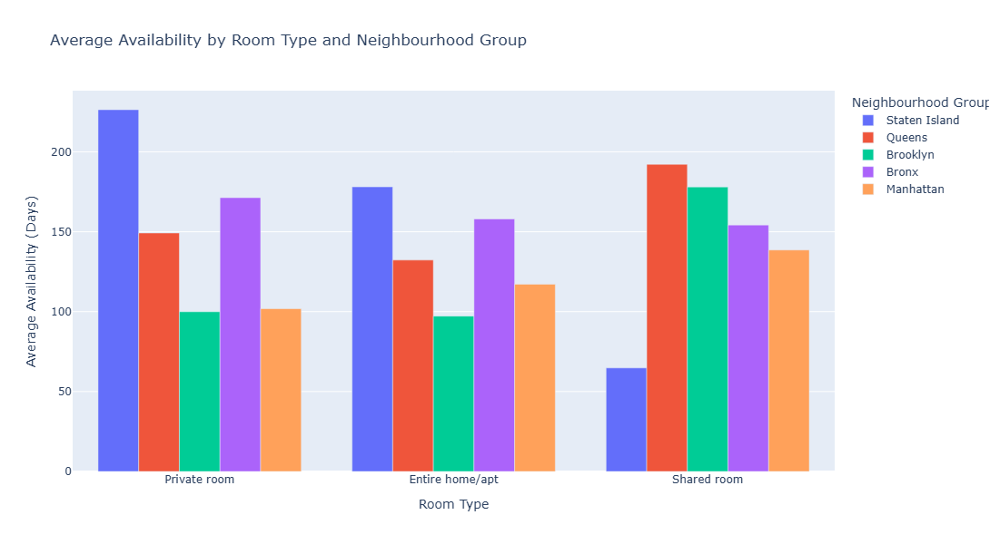

In [ ]:


# Create a bar chart with Plotly Express
fig = px.bar(
    average_avail_gr,
    x="room_type",                # Room type on x-axis
    y="availability_365",         # Average availability on y-axis
    color="neighbourhood_group",  # Different colors for neighbourhood groups
    barmode="group",              # Group bars by neighbourhood group
    title="Average Availability by Room Type and Neighbourhood Group",
    labels={
        "availability_365": "Average Availability (Days)",
        "room_type": "Room Type",
        "neighbourhood_group": "Neighbourhood Group"
    }
)

# Customize the layout
fig.update_layout(
    xaxis_title="Room Type",
    yaxis_title="Average Availability (Days)",
    legend_title="Neighbourhood Group",
    width=900,
    height=600
)

# Show the plot
fig.show()

### Average Minimum Nights by Neighbourhood Group and Room Type

In [ ]:
average_minimum_nights=airbnb_df.groupby(["neighbourhood_group", "room_type"])['minimum_nights'].mean().reset_index().sort_values('minimum_nights',ascending=False).round(2)
average_minimum_nights

,neighbourhood_group,room_type,minimum_nights
6,Manhattan,Entire home/apt,10.54
5,Brooklyn,Shared room,7.75
8,Manhattan,Shared room,6.77
3,Brooklyn,Entire home/apt,6.53
12,Staten Island,Entire home/apt,6.24
0,Bronx,Entire home/apt,5.96
4,Brooklyn,Private room,5.54
7,Manhattan,Private room,5.45
9,Queens,Entire home/apt,5.37
10,Queens,Private room,5.12


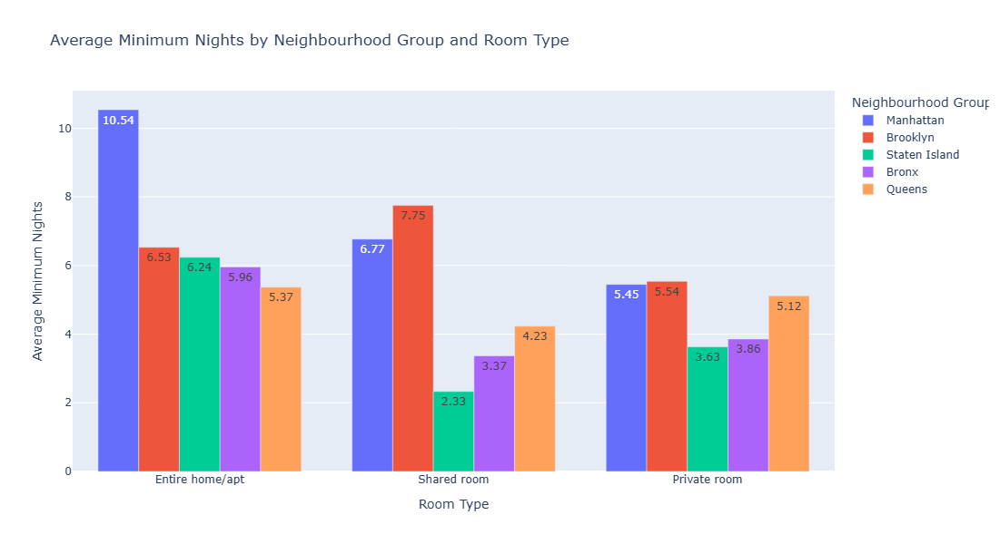

In [ ]:

fig = px.bar(
    average_minimum_nights,
    x="room_type",
    y="minimum_nights",           # Average minimum nights on the y-axis
    color="neighbourhood_group",  # Color bars by neighbourhood group
    barmode="group",
    text='minimum_nights',# Group bars for each room type
    title="Average Minimum Nights by Neighbourhood Group and Room Type",
    labels={
        "minimum_nights": "Average Minimum Nights",
        "room_type": "Room Type",
        "neighbourhood_group": "Neighbourhood Group"
    }
)

# Customize the layout
fig.update_layout(
    xaxis_title="Room Type",
    yaxis_title="Average Minimum Nights",
    legend_title="Neighbourhood Group",
    width=1000,  # Set the width of the chart
    height=600   # Set the height of the chart
)

# Show the figure
fig.show()

# **Price Analysis of airbnb_df Listings**

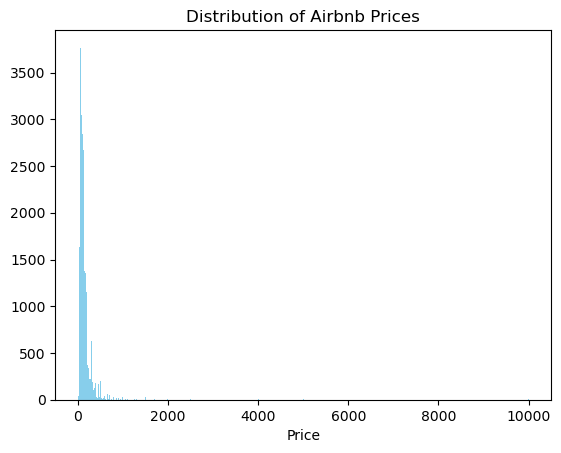

In [ ]:
plt.hist(airbnb_df['price'], bins=1000, color='skyblue')
plt.title('Distribution of airbnb_df Prices')
plt.xlabel('Price')
plt.show()

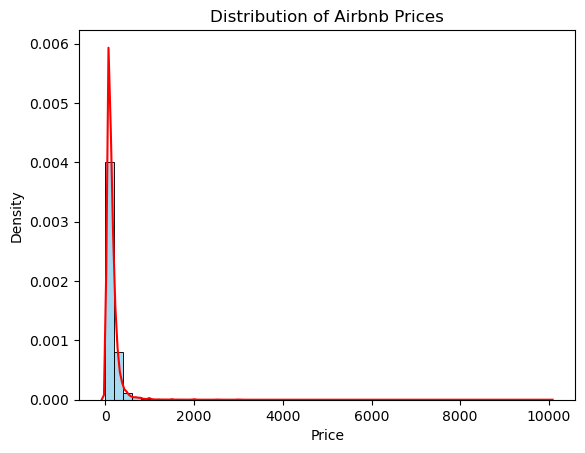

In [ ]:
ax = sns.histplot(airbnb_df, x='price', bins=50, stat="density", color='skyblue')
ax1 =sns.kdeplot(airbnb_df['price'], color='red')
ax1.set_title('Distribution of airbnb_df Prices')
ax1.set_xlabel('Price');

## Top 5 Price Listings

In [ ]:
top_price = airbnb_df.price.value_counts().nlargest(5).reset_index()
top_price

,price,count
0,100,2051
1,150,2047
2,50,1534
3,60,1458
4,200,1401


Text(0, 0.5, 'Price (USD)')

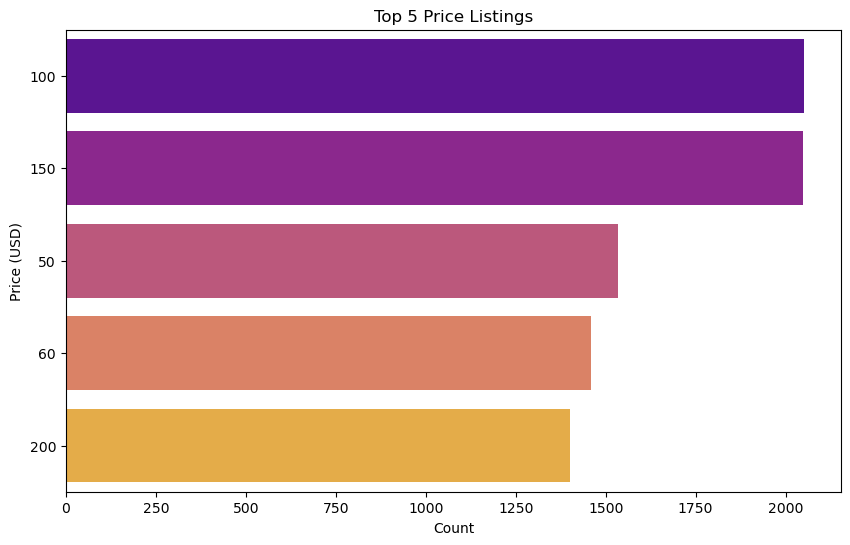

In [ ]:
plt.figure(figsize=(10, 6))
sns.barplot(x='count', y='price', data=top_price, orient='h', palette='plasma', order=top_price['price'])  # Changed x and y, and order
plt.title('Top 5 Price Listings')
plt.xlabel('Count')  # xlabel remains 'Count' as it represents the frequency
plt.ylabel('Price (USD)')

The plot above shows that the most frequently used prices are all round numbers ending with zero. $100 has the most common price listings with a count of 2051

## Top 20 Neighbourhoods by Mean Price

In [ ]:
top_neighbourhoods=airbnb_df.groupby(['neighbourhood', 'neighbourhood_group'])['price'].mean().reset_index().sort_values('price',ascending=False).head(20).round(2)
top_neighbourhoods

,neighbourhood,neighbourhood_group,price
82,Fort Wadsworth,Staten Island,800.00
219,Woodrow,Staten Island,700.00
197,Tribeca,Manhattan,490.64
174,Sea Gate,Brooklyn,487.86
167,Riverdale,Bronx,442.09
157,Prince's Bay,Staten Island,409.50
6,Battery Park City,Manhattan,367.56
75,Flatiron District,Manhattan,341.92
161,Randall Manor,Staten Island,336.00
144,NoHo,Manhattan,295.72


### Heat Map showiing Top 20 Neighbourhoods by Mean Price

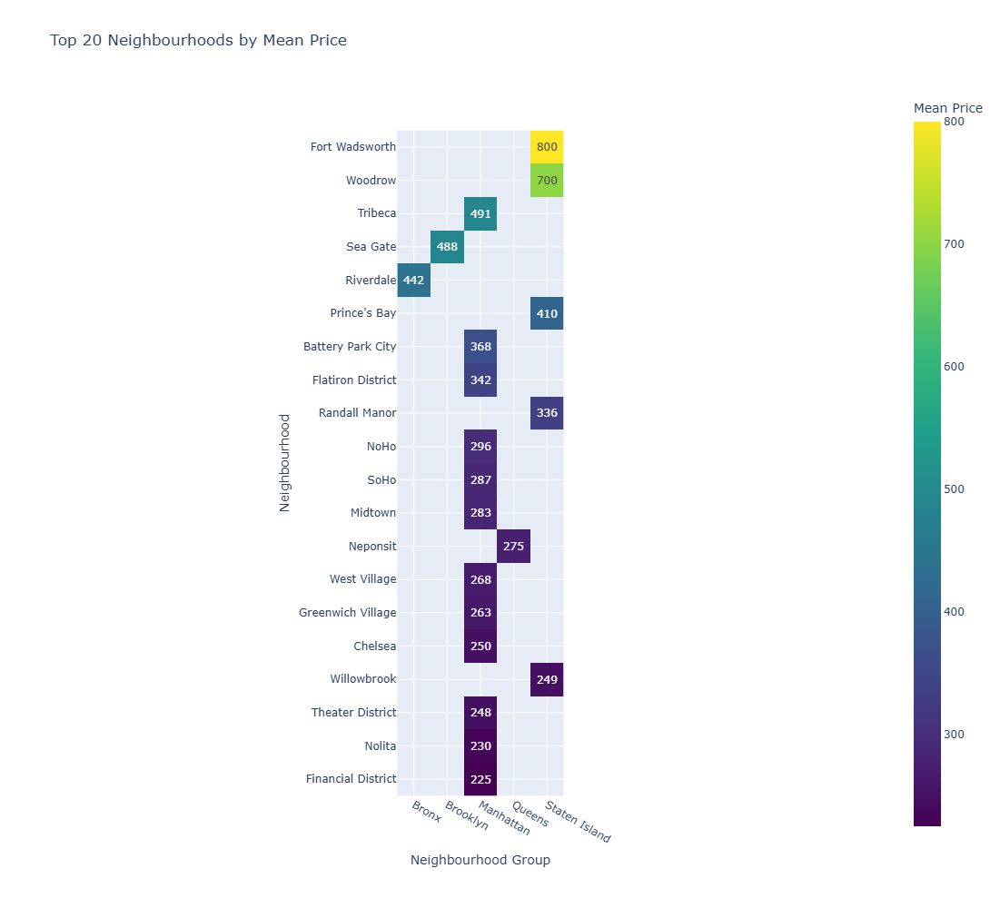

<Figure size 2000x2000 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,20))
# Group by neighbourhood and neighbourhood_group, calculate the mean price
heatmap_data = airbnb_df.groupby(['neighbourhood', 'neighbourhood_group']).price.mean()

# Sort values and select the top 20 by price
heatmap_data = heatmap_data.sort_values(ascending= False).head(20).round(0)

# Unstack the data to create a pivot table (matrix format required for heatmaps)
heatmap_data_matrix = heatmap_data.unstack()

# Create the heatmap with Plotly Express
# Use 'rocket' instead of px.colors.sequential.Rocket
fig = px.imshow(
    heatmap_data_matrix,
    labels=dict(x="Neighbourhood Group", y="Neighbourhood", color="Mean Price"),
    title="Top 20 Neighbourhoods by Mean Price",
    text_auto=True,
    color_continuous_scale='viridis',  # Changed to 'rocket'
)

# Customize the layout
fig.update_layout(
    width=1200,  # Adjust figure size
    height=1000,  # Adjust figure size
    xaxis_title="Neighbourhood Group",
    yaxis_title="Neighbourhood",
    coloraxis_colorbar=dict(title="Mean Price")  # Customize colorbar label
)

# Show the heatmap
fig.show()

### Open-Street Map showiing Top 20 Neighbourhoods by Mean Price

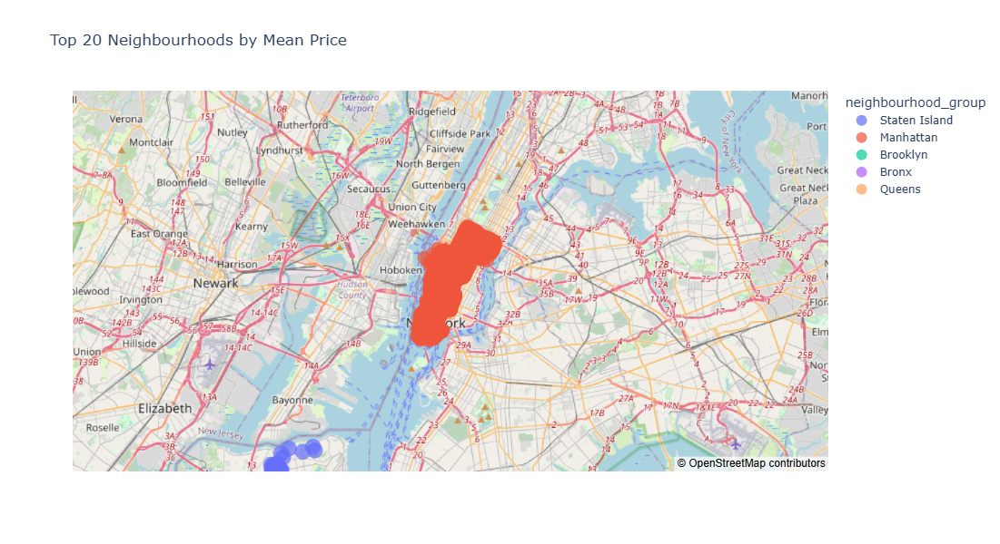

In [ ]:


# Group by neighbourhood and neighbourhood_group, calculate the mean price
top_neighbourhoods = (
    airbnb_df.groupby(['neighbourhood', 'neighbourhood_group'])['price']
    .mean()
    .sort_values(ascending=False)
    .head(20)
    .reset_index()
)

# Merge with the original airbnb_df dataset to include latitude and longitude
top_neighbourhoods = top_neighbourhoods.merge(airbnb_df[['neighbourhood', 'latitude', 'longitude']].drop_duplicates(),
                                              on='neighbourhood',
                                              how='left')

# Create a scatter mapbox
fig = px.scatter_mapbox(
    top_neighbourhoods,
    lat='latitude',                # Latitude for map points
    lon='longitude',               # Longitude for map points
    size='price',                  # Use price to size the markers
    color='neighbourhood_group',   # Color points by neighbourhood_group
    hover_name='neighbourhood',    # Display neighbourhood on hover
    hover_data={'price': True, 'latitude': False, 'longitude': False},  # Show price, hide lat/lon
    title="Top 20 Neighbourhoods by Mean Price",
    color_continuous_scale='viridis',  # Rocket color scale
    zoom=10,                     # Adjust map zoom level
    height=600                   # Set map height
)

# Set map style
fig.update_layout(mapbox_style="open-street-map")

# Show the map
fig.show()


### Average Price by Neighbourhood Group and Room Type

In [ ]:
average_price=airbnb_df.groupby(["neighbourhood_group", "room_type"])['price'].mean().reset_index().sort_values('price',ascending=False).round(2)
average_price

,neighbourhood_group,room_type,price
6,Manhattan,Entire home/apt,249.24
3,Brooklyn,Entire home/apt,178.33
12,Staten Island,Entire home/apt,173.85
9,Queens,Entire home/apt,147.05
0,Bronx,Entire home/apt,127.51
7,Manhattan,Private room,116.78
8,Manhattan,Shared room,88.98
4,Brooklyn,Private room,76.50
10,Queens,Private room,71.76
11,Queens,Shared room,69.02


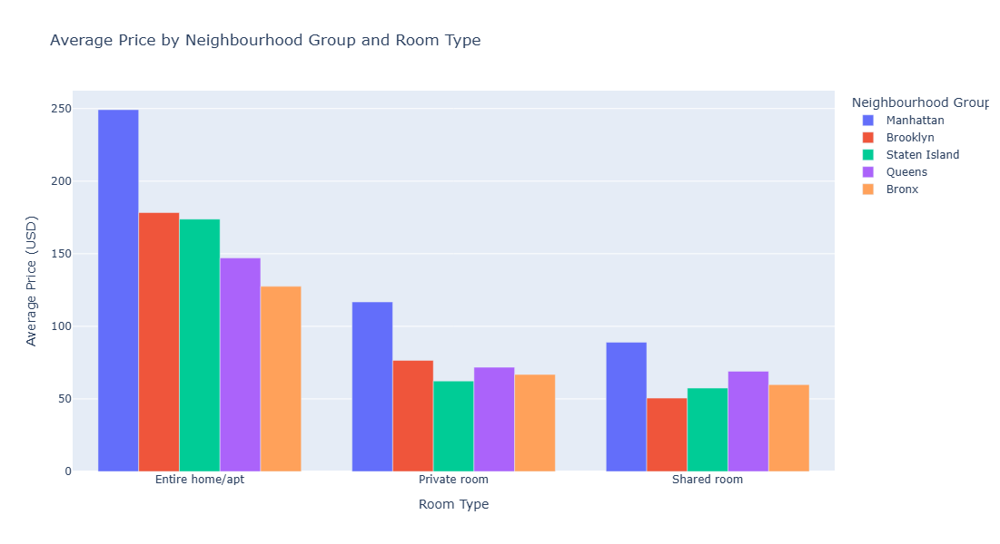

In [ ]:
fig = px.bar(
    average_price,
    x="room_type",                # Room type on the x-axis
    y="price",                    # Average price on the y-axis
    color="neighbourhood_group",  # Color bars by neighbourhood group
    barmode="group",              # Group bars for each room type
    title="Average Price by Neighbourhood Group and Room Type",
    labels={
        "price": "Average Price (USD)",
        "room_type": "Room Type",
        "neighbourhood_group": "Neighbourhood Group"
    }
)

# Customize the layout
fig.update_layout(
    xaxis_title="Room Type",
    yaxis_title="Average Price (USD)",
    legend_title="Neighbourhood Group",
    width=1000,  # Adjust chart width
    height=600   # Adjust chart height
)

# Show the figure
fig.show()

This shows that the mean price of an airbnb_df listing is 153. The min price of listing is 0 and the maximum is $10000. 75% of price listing is below 175 USD and below, and the maximum price is 10000. The price is greatly skewed with huge outliers.

# Machine Learning

In [ ]:
airbnb_df['price'].describe()

count    48895.000000
mean       152.720687
std        240.154170
min          0.000000
25%         69.000000
50%        106.000000
75%        175.000000
max      10000.000000
Name: price, dtype: float64

This shows that the mean price of an airbnb_df listing is 153. The min price of listing is 0 and the maximum is $10000. 75% of price listing is below 175 USD and below, and the maximum price is 10000. The price is greatly skewed with huge outliers.

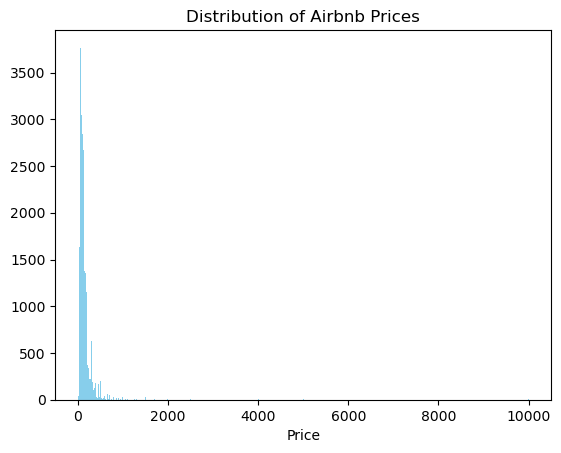

In [ ]:
plt.hist(airbnb_df['price'], bins=1000, color='skyblue')
plt.title('Distribution of airbnb_df Prices')
plt.xlabel('Price')
plt.show()

### **Logarithm Transformation of Price**

The price of listing is badly skewed, I will do a log transformation of the null zero price values. Models do not functional properly on skewed data

Remove Roles Where Price Equals Zero

In [ ]:
airbnb_df['price'].loc[airbnb_df['price'] == 0].count() #count zero values in price column

11

In [ ]:
airbnb_df = airbnb_df[airbnb_df['price'] != 0]

In [ ]:
airbnb_df['price'].loc[airbnb_df['price'] == 0].count()

0

In [ ]:
airbnb_df['log_price'] = np.log(airbnb_df['price']) #log transform and create a new column

In [ ]:
airbnb_df.head()

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,log_price
0,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365,5.003946
1,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355,5.416100
2,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,0.00,1,365,5.010635
3,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194,4.488636
4,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0,4.382027


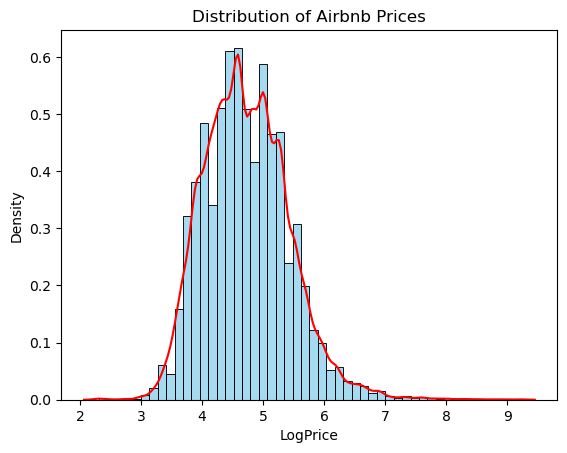

In [ ]:
ax = sns.histplot(airbnb_df, x='log_price', bins=50, stat="density", color='skyblue')
ax1 =sns.kdeplot(airbnb_df['log_price'], color='red')
ax1.set_title('Distribution of airbnb_df Prices')
ax1.set_xlabel('LogPrice');

Let's place the plots side by side and compare the distribution before and after log transformation

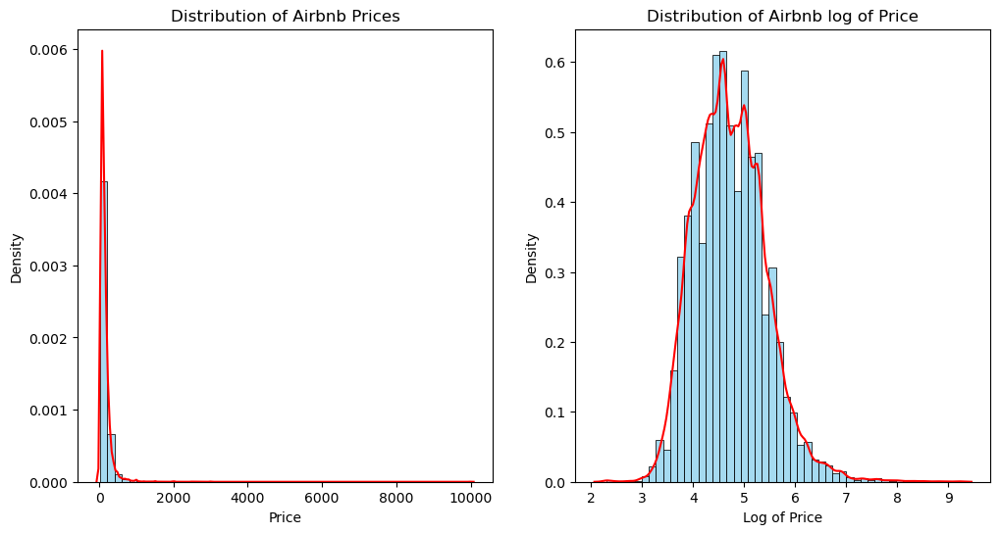

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# Pass ax=axs[0] to plot on the first subplot
sns.histplot(airbnb_df, x='price', bins=50, stat="density", color='skyblue', ax=axs[0])
sns.kdeplot(airbnb_df['price'], color='red', ax=axs[0])
axs[0].set_title('Distribution of airbnb_df Prices')
axs[0].set_xlabel('Price');

# Pass ax=axs[1] to plot on the second subplot
sns.histplot(airbnb_df, x='log_price', bins=50, stat="density", color='skyblue', ax=axs[1])
sns.kdeplot(airbnb_df['log_price'], color='red', ax=axs[1])
axs[1].set_title('Distribution of airbnb_df log of Price')
axs[1].set_xlabel('Log of Price');

In [ ]:
airbnb_df["log_price"].describe().round(2)

count    48884.00
mean         4.73
std          0.70
min          2.30
25%          4.23
50%          4.66
75%          5.16
max          9.21
Name: log_price, dtype: float64

From the above, log transformation has given us that parametric or bell curve distribution that is important for our analysis to be statistically meaningful and it has also greatly removed outliers. If your target variable is continuous log transformation can help to normalise your data and give you that parametric distribution necessary for statistical significance. Other methods of  normalization include square and cube root transformation



```
# This is formatted as code
```

### **Check Price Outliers**

I will use quantile to show the bottom 10% values and the top 10% price of listing, this will further help me to determine if we have outliers in price



In [ ]:
low, high = airbnb_df["log_price"].quantile([0.1, 0.9]) # Take quantile values and assign to variables name

In [ ]:
print(low,
high)


3.8918202981106265 5.594711379601839


### Check price distribution after removing outliers

In [ ]:
top_price_log = airbnb_df.log_price.value_counts().nlargest(5).reset_index()
top_price_log

,log_price,count
0,4.605170,2051
1,5.010635,2047
2,3.912023,1534
3,4.094345,1458
4,5.298317,1401


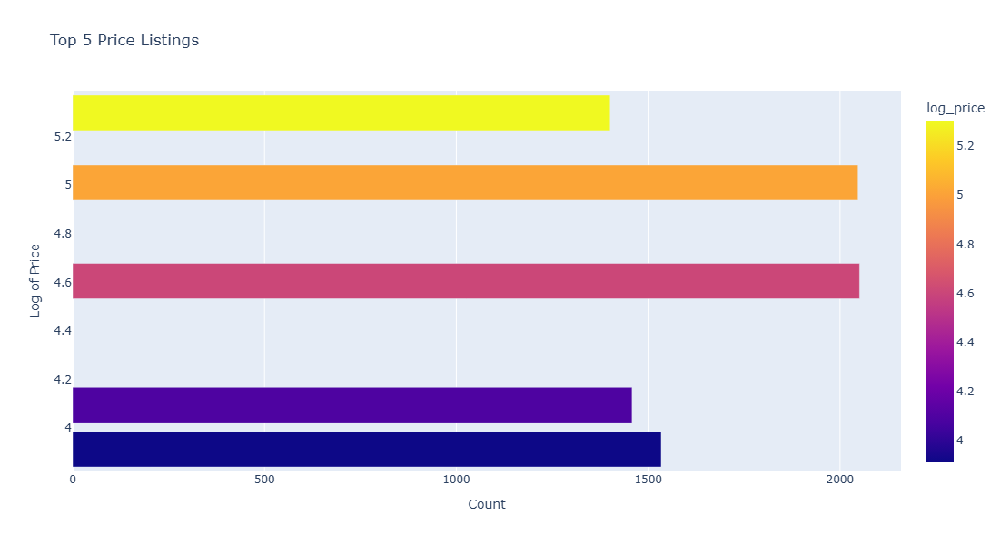

In [ ]:
fig = px.bar(
    top_price_log,
    x='count',                  # x-axis represents 'count' (frequency)
    y='log_price',                  # y-axis represents 'price'
    orientation='h',            # Horizontal orientation
    title='Top 5 Price Listings',  # Title of the chart
    color='log_price',              # Color bars by 'price' using a gradient
    color_continuous_scale='plasma'  # Use the 'plasma' color scale
)

# Customize the layout
fig.update_layout(
    xaxis_title='Count',         # Label for the x-axis
    yaxis_title='Log of Price',         # Label for the y-axis
    yaxis=dict(categoryorder='total ascending'),  # Order bars by price
    width=800,                   # Set chart width
    height=600                   # Set chart height
)

# Show the figure
fig.show()

In [ ]:
# Calculate the average price for each neighbourhood group
average_price=airbnb_df.groupby('neighbourhood_group')['price'].mean().sort_values(ascending=False).round(2)
average_price

neighbourhood_group
Manhattan        196.88
Brooklyn         124.44
Staten Island    114.81
Queens            99.52
Bronx             87.58
Name: price, dtype: float64

Neighbourhood with the highest number of airbnb_df

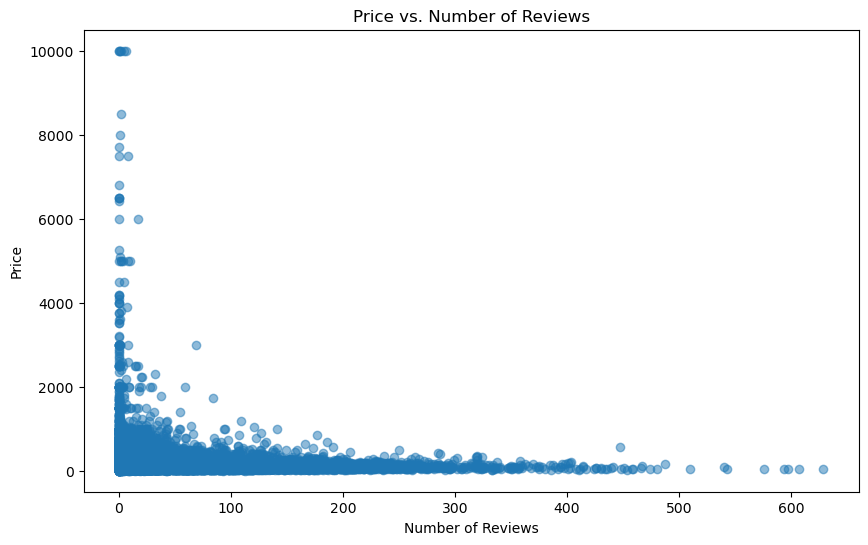

In [ ]:
# Scatter plot of prices vs. number of reviews
plt.figure(figsize=(10, 6))
plt.scatter(airbnb_df['number_of_reviews'], airbnb_df['price'], alpha=0.5)
plt.xlabel('Number of Reviews')
plt.ylabel('Price')
plt.title('Price vs. Number of Reviews')
plt.show()

**Price Correlation**

The figure below shows the coefficient of the correlation between the target variable, price ('log of price'), and the predictor variables (features). It shows that the price has the highest  correlation with count of host listings, the higher the price the higher the count of listings.  

<Axes: >

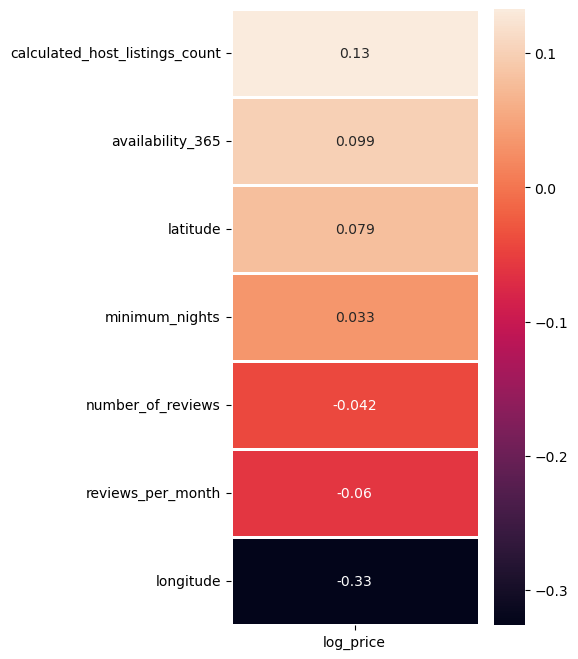

In [ ]:
plt.figure(figsize=(4,8))
# Calculate the correlation before dropping the 'price' column
correlation = airbnb_df.select_dtypes('number').drop(columns='price').corr()['log_price'].sort_values(ascending=False).to_frame()
# Now you can drop 'price' if you don't want it in the heatmap itself
correlation = correlation.drop(index='log_price')
# Plot heatmap of `correlation`
sns.heatmap(correlation, annot=True, linewidth=2)

# Model Building



```
`# This is formatted as code`
```

**Create Feature Matrix X and Target Vector y**

Creating my feature matrix X and target vector y. My target is "log_price"

In [ ]:
target = "log_price"
X = airbnb_df.drop(columns=[target, 'price'])
y = airbnb_df[target]


In [ ]:
X.columns

Index(['neighbourhood_group', 'neighbourhood', 'latitude', 'longitude',
       'room_type', 'minimum_nights', 'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365'],
      dtype='object')

### Split Dataset (80%)

Divide data (X and y) into training and test sets using randomized train-test split. Test set is 20% of  total data. Random_state for reproducibility is 42

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)

X_train shape: (39107, 10)
y_train shape: (39107,)
X_test shape: (9777, 10)
y_test shape: (9777,)


In [ ]:
y_train.mean()

4.727598311272868

## Baseline Mean Absolute Error
What is Baseline MAE?
The Baseline MAE serves as a benchmark to evaluate how much better (or worse)
 a regression model performs compared to its bseline.

If a model's MAE is significantly lower than the Baseline MAE, it indicates that the model has learned meaningful patterns from the features, and if a model's MAE is close to or worse than the Baseline MAE, it suggests that:
1. The model is not effectively learning patterns.
2. The features might not be informative.
3. The model might require improvement (e.g., feature engineering, hyperparameter tuning, or switching to a more complex model).





In [ ]:
# Baseline MAE using mean of y
baseline_mae = abs(y_test - y_test.mean()).mean()
print(f"Baseline MAE: {baseline_mae}")

Baseline MAE: 0.5563692349799404


# Machine Learing Pipeline

## Ridge Regression

In [ ]:
# Build model
model = make_pipeline(
    OneHotEncoder(use_cat_names=True),
    StandardScaler(),
    SimpleImputer(strategy='mean'), #categorical data, you can use SimpleImputer(strategy='most_frequent')
    Ridge(),


)
# Fit model to training data
model.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['neighbourhood_group', 'neighbourhood',
                                     'room_type'],
                               use_cat_names=True)),
                ('standardscaler', StandardScaler()),
                ('simpleimputer', SimpleImputer()), ('ridge', Ridge())])

In [ ]:
## Evaluate

In [ ]:
#Recall Baseline
print(f"Baseline MAE: {baseline_mae}")

Baseline MAE: 0.5563692349799404


In [ ]:
acc_train = mean_absolute_error(y_train, model.predict(X_train))
acc_test = model.score(X_test, y_test )

print("Training Accuracy:", round(acc_train, 2))
print("Test Accuracy:", round(acc_test, 2))

Training Accuracy: 0.34
Test Accuracy: 0.53


In [ ]:
ridge_pred = model.predict(X_test)

In [ ]:
mae = mean_absolute_error(y_test, ridge_pred)
mse = mean_squared_error(y_test, ridge_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, ridge_pred)

In [ ]:
print("Performance Metrics:")
print(f"Baseline MAE: {baseline_mae}")
print(f'Mean Absolute Error: {mae}')
print(f'Mean Squared Error: {mse}')
print(f'Root Mean Squared Error: {rmse}')
print(f'R-squared: {r2}')

Performance Metrics:
Baseline MAE: 0.5563692349799404
Mean Absolute Error: 0.3463794700498891
Mean Squared Error: 0.2322500436804255
Root Mean Squared Error: 0.48192327571972027
R-squared: 0.5253740675116862


## Evaluate

## Communicate Results

Create a Series named feat_imp. The index should contain the names of all the features your model considers when making predictions; the values should be the coefficient values associated with each feature. The Series should be sorted ascending by absolute value.

In [ ]:
coefficients = model.named_steps["ridge"].coef_
features = model.named_steps["onehotencoder"].get_feature_names()
feat_imp = pd.Series(coefficients, index=features)
feat_imp.head()

neighbourhood_group_Queens           0.017574
neighbourhood_group_Brooklyn        -0.041865
neighbourhood_group_Bronx           -0.001412
neighbourhood_group_Manhattan        0.039135
neighbourhood_group_Staten Island   -0.049619
dtype: float64

In [ ]:
feat_imp.sort_values(key=abs)

neighbourhood_Pelham Gardens    -0.000143
neighbourhood_Middle Village    -0.000246
neighbourhood_North Riverdale    0.000439
neighbourhood_Wakefield          0.000440
neighbourhood_Willowbrook       -0.000447
                                   ...   
availability_365                 0.103653
room_type_Shared room           -0.107806
room_type_Private room          -0.160956
room_type_Entire home/apt        0.193366
longitude                       -0.219073
Length: 233, dtype: float64

Text(0.5, 1.0, 'Feature Importances for Apartment Price')

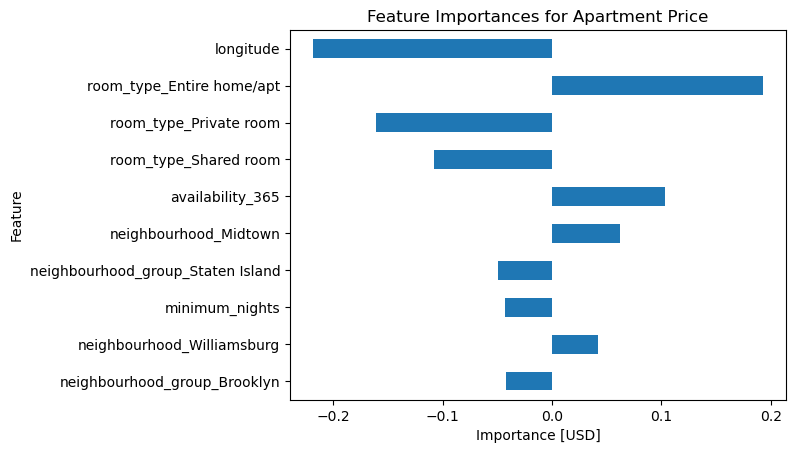

In [ ]:
feat_imp.sort_values(key=abs).tail(10).plot(kind='barh')

# Label axes
plt.xlabel("Importance [USD]")
plt.ylabel("Feature")

# Add title
plt.title("Feature Importances for Apartment Price")


# Don't delete the code below 👇


## RANDOM FOREST

**Build Model**

In [ ]:
# Build model
model = make_pipeline(
    OneHotEncoder(use_cat_names=True),
    StandardScaler(),
    RandomForestRegressor(n_estimators=100, random_state=42)
)
# Fit model to training data
model.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['neighbourhood_group', 'neighbourhood',
                                     'room_type'],
                               use_cat_names=True)),
                ('standardscaler', StandardScaler()),
                ('randomforestregressor',
                 RandomForestRegressor(random_state=42))])

In [ ]:
rf_pred = model.predict(X_test)


In [ ]:
mae = mean_absolute_error(y_test,rf_pred)
mse = mean_squared_error(y_test, rf_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, rf_pred)

In [ ]:
print("Performance Metrics:")
print(f'Mean Absolute Error: {mae}')
print(f'Mean Squared Error: {mse}')
print(f'Root Mean Squared Error: {rmse}')
print(f'R-squared: {r2}')

Performance Metrics:
Mean Absolute Error: 0.31693186862718015
Mean Squared Error: 0.20284837386578777
Root Mean Squared Error: 0.45038691573555706
R-squared: 0.5854592874382222


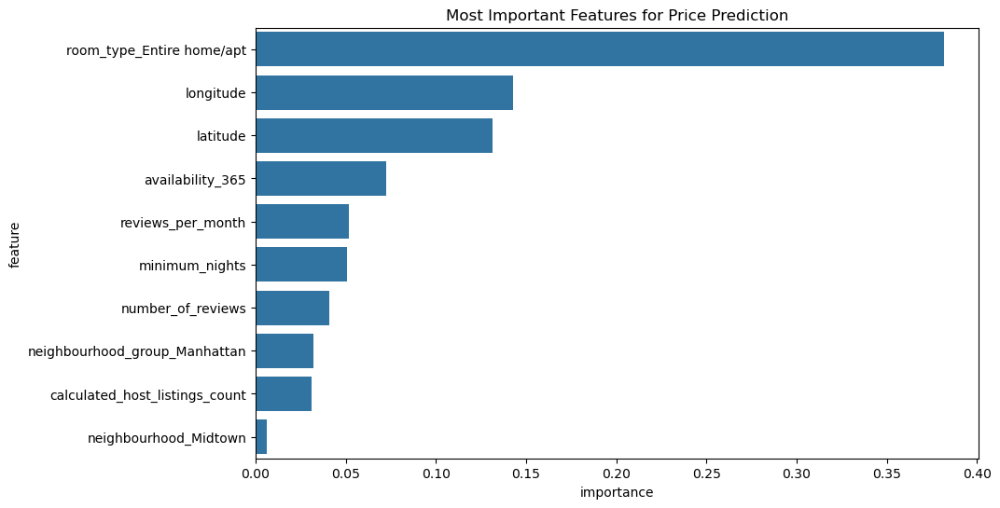

In [ ]:
# Access the RandomForestRegressor within the pipeline
feature_importance = pd.DataFrame({'feature': model.named_steps['onehotencoder'].get_feature_names_out(X.columns), # Get feature names after OneHotEncoding
                                  'importance': model.named_steps['randomforestregressor'].feature_importances_})

# Rest of the code remains the same
feature_importance = feature_importance.sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='importance', y='feature', data=feature_importance.head(10))
plt.title('Most Important Features for Price Prediction')
plt.show()

## COMPARE MODELS: RIDGE REGRESSION AND RANDOM FOREST

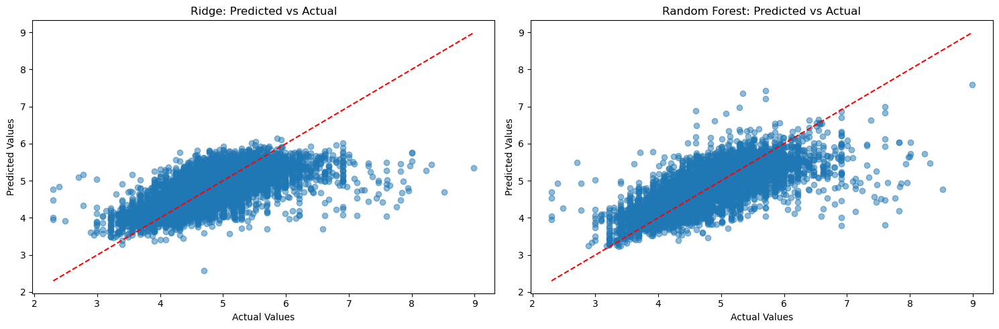

In [ ]:
    # Plot predictions vs actual
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

    ax1.scatter(y_test, ridge_pred, alpha=0.5)
    ax1.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
    ax1.set_title('Ridge: Predicted vs Actual')
    ax1.set_xlabel('Actual Values')
    ax1.set_ylabel('Predicted Values')

    ax2.scatter(y_test, rf_pred, alpha=0.5)
    ax2.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
    ax2.set_title('Random Forest: Predicted vs Actual')
    ax2.set_xlabel('Actual Values')
    ax2.set_ylabel('Predicted Values')

    plt.tight_layout()
    plt.show()

In [ ]:
metrics = {}
for name, pred in [("Ridge", ridge_pred), ("Random Forest", rf_pred)]:
  metrics[name] = {"MAE": mean_absolute_error(y_test, pred),
            "MSE": mean_squared_error(y_test, pred),
            "RMSE": np.sqrt(mean_squared_error(y_test, pred)),
            "R2": r2_score(y_test, pred)}

In [ ]:
 # Print detailed metrics comparison
print("\nDetailed Metrics Comparison:")
for metric in ["MAE", "MSE", "RMSE", "R2"]:
  print(f"\n{metric}:")
  for model in metrics:
    print(f"{model}: {metrics[model][metric]:.4f}")


Detailed Metrics Comparison:

MAE:
Ridge: 0.3464
Random Forest: 0.3169

MSE:
Ridge: 0.2323
Random Forest: 0.2028

RMSE:
Ridge: 0.4819
Random Forest: 0.4504

R2:
Ridge: 0.5254
Random Forest: 0.5855


## Performance Analysis:

### Overall Performance

Random Forest performs better across all metrics:
* 8.4% improvement in MAE
* 6.6% improvement in RMSE
* 11.2% improvement in R² score


### Specific Improvements

* MAE reduced from 0.346 to 0.317---
Since we're working with log prices, this means predictions are typically off by exp(0.317) ≈ 1.37 compared to Ridge's 1.41


* R² increased from 0.526 to 0.585
--- Random Forest explains 58.5% of price variance vs Ridge's 52.6%
---This suggests better capture of non-linear relationships in the data


### Why Random Forest Performs Better
* Better handles non-linear relationships between features
* Automatically captures feature interactions
* More robust to outliers in the dataset
* Can model complex patterns in neighborhood and location data



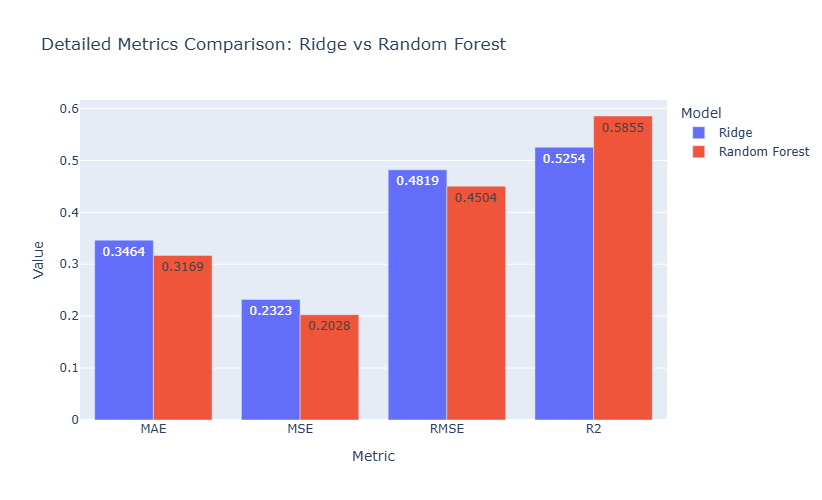

In [ ]:
# Create a DataFrame for the metrics
metrics_data = {
    'Metric': ['MAE', 'MSE', 'RMSE', 'R2'],
    'Ridge': [0.3464, 0.2323, 0.4819, 0.5254],
    'Random Forest': [0.3169, 0.2028, 0.4504, 0.5855]
}

metrics_df = pd.DataFrame(metrics_data)

# Melt the DataFrame for Plotly
metrics_melted = metrics_df.melt(id_vars='Metric',
                                  value_vars=['Ridge', 'Random Forest'],
                                  var_name='Model',
                                  value_name='Value')

# Create a grouped bar chart
fig = px.bar(
    metrics_melted,
    x='Metric',          # Metrics on the x-axis (e.g., MAE, MSE, etc.)
    y='Value',           # Corresponding values on the y-axis
    color='Model',       # Different colors for Ridge and Random Forest
    barmode='group',     # Grouped bars for easy comparison
    title='Detailed Metrics Comparison: Ridge vs Random Forest',
    labels={'Value': 'Metric Value', 'Metric': 'Metric'},
    text='Value'         # Display values on top of the bars
)

# Customize the layout
fig.update_layout(
    xaxis_title='Metric',
    yaxis_title='Value',
    legend_title='Model',
    width=800,
    height=500
)

# Show the plot
fig.show()

The graph clearly shows that Random Forest (red bars) outperforms Ridge Regression (purple bars) across all metrics:

1. Lower error metrics (MAE, MSE, RMSE)
2. Higher R² score

### Save Random Forest Model

In [ ]:
import pickle
with open('model.pkl' , 'wb') as file : #model.pkl is my pickle file in binary write mode('wb')
    pickle.dump(model, file)

 ## **Summary and Conclusion:**

## Exploratory Data Analysis (EDA)
The EDA process was instrumental in uncovering patterns and relationships in the dataset. Key observations include:

1. ### Neighbourhood Group Distribution:
The dataset revealed that most listings were concentrated in Manhattan and Brooklyn, with fewer listings in Queens, Bronx, and Staten Island.
Manhattan listings exhibited higher average prices, reflecting its premium market status.

2. ### Room Type Insights:
Listings were categorised into Entire home/apt, Private room, and Shared room.
Entire homes commanded the highest average prices, while shared rooms were the least expensive.
Private rooms had significant variability in pricing, influenced by location and other factors.

3. ### Price Distribution:
Price data exhibited a right-skewed distribution, with most listings priced below $200 per night.
Outliers included luxury properties with prices exceeding $1,000 per night. These outliers were addressed by doing a log transformation of price during data preprocessing.

4. ### Availability:
The availability_365 feature showed that many properties were available for fewer than 100 days annually, indicating the presence of part-time rentals.


5. ### A heatmap of correlations revealed that:
availability_365 and number_of_reviews had weak correlations with price.
Categorical features like neighbourhood group and room type appeared to play a more significant role.

6. ### Feature Importance:

Random Forest's feature importance analysis highlighted neighbourhood group, room type, and minimum nights as the most influential factors in predicting price.

## Machine Learning
This project demonstrated the comparative strengths of Ridge Regression and Random Forest models in predicting airbnb_df prices. The analysis revealed that Random Forest outperformed Ridge Regression across all evaluation metrics. Random Forest achieved a lower MAE (0.3169 vs. 0.3464) and RMSE (0.4504 vs. 0.4819), indicating smaller prediction errors. Additionally, its higher R² (0.5855 vs. 0.5254) showed that it explained more variance in the target variable.

The results suggest that Random Forest is better suited for this dataset because it can capture complex, non-linear relationships between features and the target variable. In contrast, Ridge Regression, while effective for linear relationships and mitigating multicollinearity, struggled to achieve comparable accuracy in this context.

Future work could explore further hyperparameter tuning, feature engineering, and the use of advanced boosting models like XGBoost or LightGBM to enhance prediction accuracy. These findings reinforce the importance of selecting models based on the nature of the data and the problem at hand, particularly in domains such as real estate where diverse and complex factors influence price prediction.

